# Beeldmaterial All

Found 20 RGB tiles in: ../data/5m_rgb


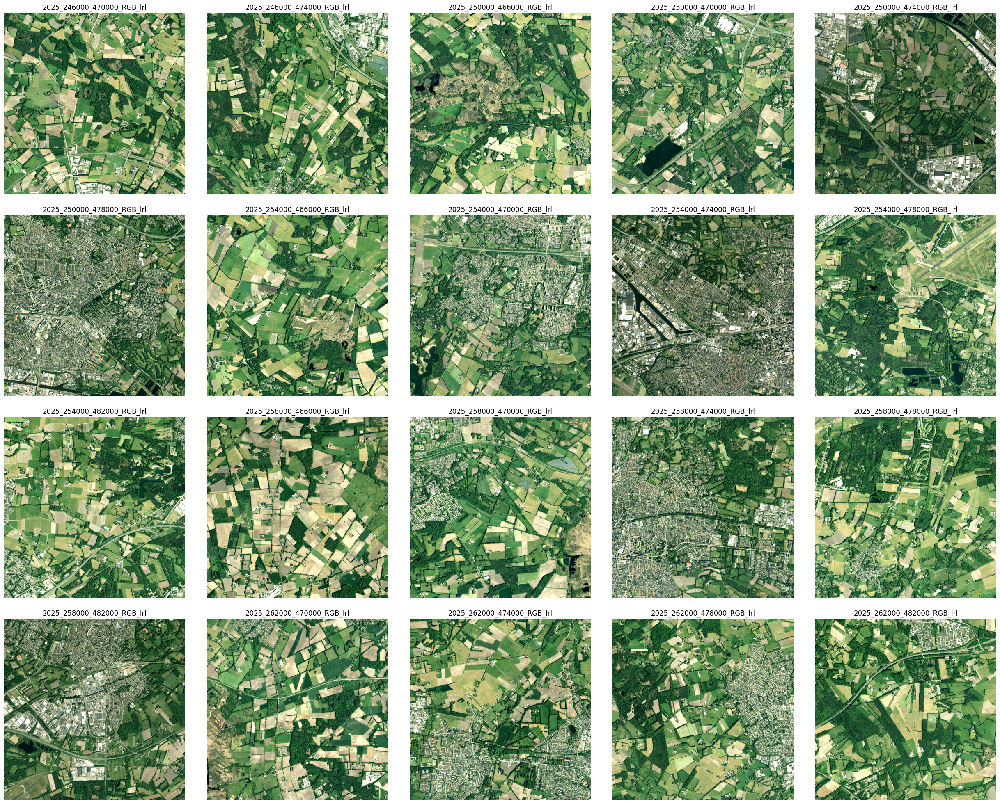

In [54]:
# ===============================
# DISPLAY ALL 20 RGB TILES (7x3 GRID)
# ===============================
import matplotlib.pyplot as plt
import numpy as np
import rasterio
from pathlib import Path

# -------------------------------
# SETTINGS
# -------------------------------
rgb_folder = Path("../data/5m_rgb")  # folder containing all 20 RGB tiles
rgb_files = sorted(rgb_folder.glob("*.tif"))
print(f"Found {len(rgb_files)} RGB tiles in: {rgb_folder}")

if len(rgb_files) == 0:
    raise ValueError("No RGB .tif tiles found in the specified folder.")

nrows, ncols = 4, 5  # fixed grid for 20 tiles (21st will be hidden)

# -------------------------------
# PREPARE FIGURE
# -------------------------------
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(5*ncols, 5*nrows))
axes = np.array(axes).reshape(-1)

# -------------------------------
# DISPLAY EACH RGB TILE
# -------------------------------
for ax, tif_path in zip(axes, rgb_files):
    with rasterio.open(tif_path) as src:
        # Read RGB bands (1,2,3)
        rgb = src.read([1, 2, 3]).astype(np.float32)

        # Percentile stretch for better visual contrast
        rgb_min, rgb_max = np.percentile(rgb, (2, 98))
        rgb = np.clip((rgb - rgb_min) / (rgb_max - rgb_min + 1e-6), 0, 1)

        # Transpose to (H, W, 3)
        rgb = np.transpose(rgb, (1, 2, 0))

    ax.imshow(rgb)
    ax.set_title(tif_path.stem, fontsize=12)
    ax.axis("off")

# Hide unused subplots
if len(axes) > len(rgb_files):
    for ax in axes[len(rgb_files):]:
        ax.axis("off")

# Explicitly hide 21st subplot if it exists
if len(axes) >= 21:
    axes[20].axis("off")

#plt.suptitle("Beeldmaterial Orthophotos (Enschede, 5m Resolution)", fontsize=60, y=1.00)
plt.tight_layout()
plt.show()

# NDVI Tiles

Found 20 NDVI tiles in: ../data/ndvi


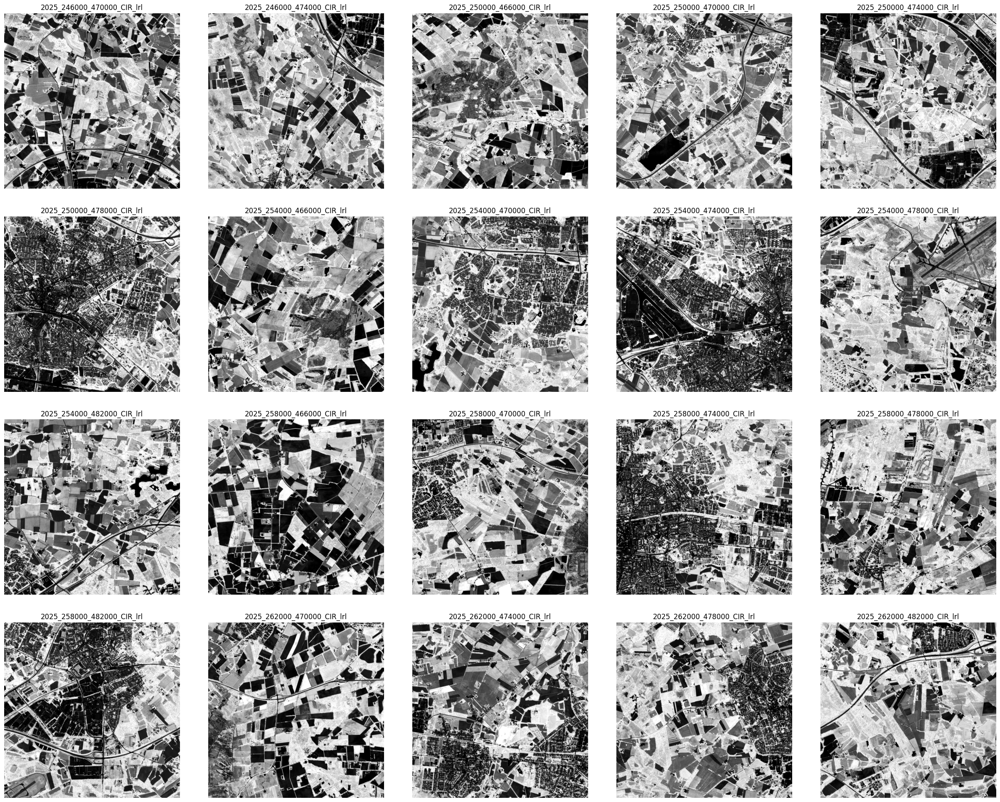

In [79]:
# ===============================
# DISPLAY ALL 20 RGB TILES (7x3 GRID)
# ===============================
import matplotlib.pyplot as plt
import numpy as np
import rasterio
from pathlib import Path

# -------------------------------
# SETTINGS
# -------------------------------
rgb_folder = Path("../data/ndvi")  # folder containing all 20 RGB tiles
rgb_files = sorted(rgb_folder.glob("*.tif"))
print(f"Found {len(rgb_files)} NDVI tiles in: {rgb_folder}")

if len(rgb_files) == 0:
    raise ValueError("No RGB .tif tiles found in the specified folder.")

nrows, ncols = 4, 5  # fixed grid for 20 tiles (21st will be hidden)

# -------------------------------
# PREPARE FIGURE
# -------------------------------
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(5*ncols, 5*nrows))
axes = np.array(axes).reshape(-1)

# -------------------------------
# DISPLAY EACH RGB TILE
# -------------------------------
for ax, tif_path in zip(axes, rgb_files):
    with rasterio.open(tif_path) as src:
        ndvi = src.read(1).astype(np.float32)

        # Percentile stretch for contrast
        ndvi_min, ndvi_max = np.percentile(ndvi, (2, 98))
        ndvi = np.clip((ndvi - ndvi_min) / (ndvi_max - ndvi_min + 1e-6), 0, 1)

    ax.imshow(ndvi, cmap="gray")
    ax.set_title(tif_path.stem, fontsize=12)
    ax.axis("off")

# Hide unused subplots
if len(axes) > len(rgb_files):
    for ax in axes[len(rgb_files):]:
        ax.axis("off")

#plt.suptitle("Beeldmaterial Orthophotos (Enschede, 5m Resolution)", fontsize=60, y=1.00)
plt.tight_layout()
plt.show()

# Training/ Testing

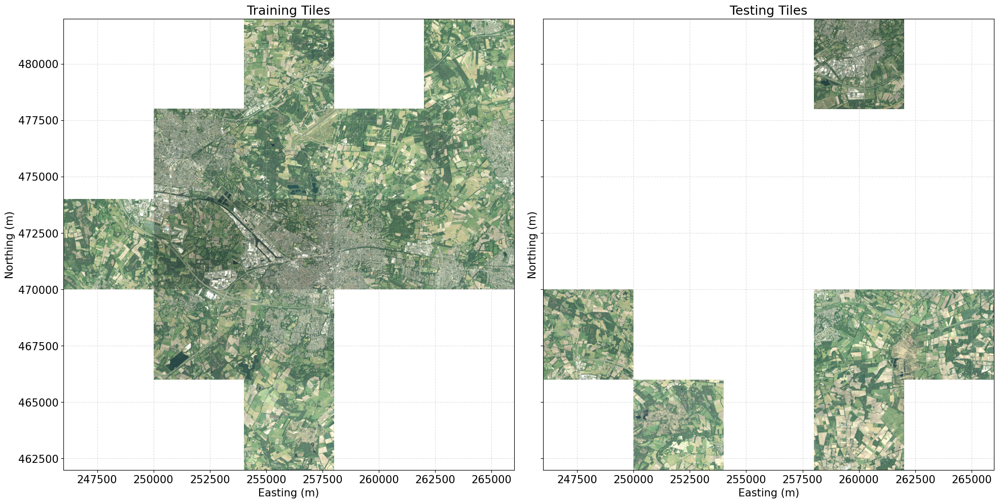

In [62]:
import matplotlib.pyplot as plt
import rasterio
from rasterio.plot import plotting_extent
from pathlib import Path
import numpy as np

# ===============================
# GLOBAL FONT SETTINGS
# ===============================
plt.rcParams.update({'font.size': 15})   # <--- change this value to scale everything

# ===============================
# FOLDERS
# ===============================
train_folder = Path("../data/train_rgb")
test_folder  = Path("../data/test_rgb")

# ===============================
# HELPER FUNCTION
# ===============================
def load_tile_data(folder, max_tiles=None):
    """Read tile image and extent for plotting (downsampled)."""
    tiles = []
    tif_files = sorted(folder.glob("*.tif"))
    if max_tiles:
        tif_files = tif_files[:max_tiles]
    for tif_path in tif_files:
        with rasterio.open(tif_path) as src:
            img = src.read(out_dtype=np.uint8)
            img = np.clip(img / np.percentile(img, 99), 0, 1)
            extent = plotting_extent(src)
            tiles.append((img, extent, tif_path.name))
    return tiles

# ===============================
# READ TRAIN/TEST DATA
# ===============================
train_tiles = load_tile_data(train_folder)
test_tiles  = load_tile_data(test_folder)

# Determine global extent
all_extents = [t[1] for t in train_tiles + test_tiles]
xmin = min(e[0] for e in all_extents)
xmax = max(e[1] for e in all_extents)
ymin = min(e[2] for e in all_extents)
ymax = max(e[3] for e in all_extents)

# ===============================
# PLOT SUBPLOTS
# ===============================
fig, axes = plt.subplots(1, 2, figsize=(20, 20), sharex=True, sharey=True)

for ax, tiles, title in zip(
    axes,
    [train_tiles, test_tiles],
    ["Training Tiles", "Testing Tiles"]
):
    for img, extent, name in tiles:
        if img.shape[0] >= 3:
            ax.imshow(np.moveaxis(img[:3], 0, -1), extent=extent)
        else:
            ax.imshow(img[0], cmap="gray", extent=extent)

    ax.set_title(title)                   # fontsize auto from rcParams
    ax.set_xlabel("Easting (m)")          # same
    ax.set_ylabel("Northing (m)")
    ax.set_aspect("equal", adjustable="box")
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.grid(True, linestyle="--", alpha=0.4)

# Optional global title
#fig.suptitle("Spatial Distribution of Training and Testing Orthophoto Tiles")

plt.tight_layout()
#plt.subplots_adjust(top=0.9)
plt.show()

# LGN

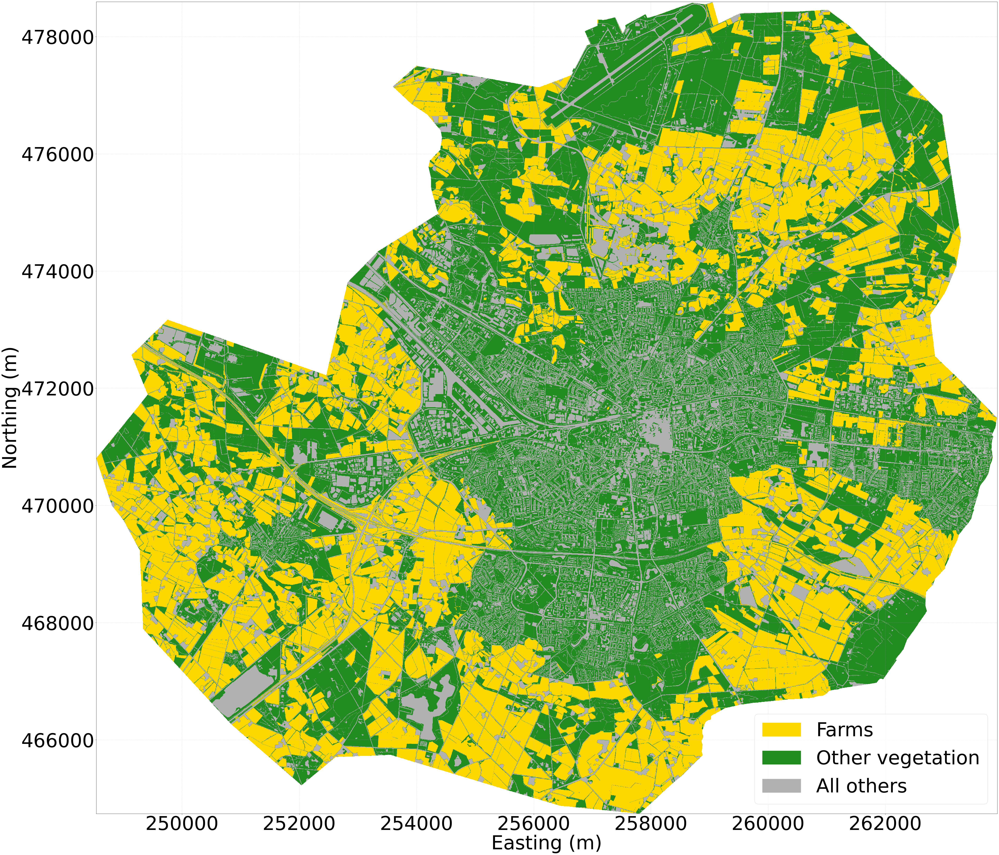

In [51]:
import matplotlib.pyplot as plt
import numpy as np
import rasterio
from rasterio.plot import plotting_extent
from matplotlib.colors import ListedColormap, BoundaryNorm
from matplotlib.patches import Patch

# ===============================
# LOAD RASTER
# ===============================
lulc_raster = "../data/lulc/three_class.tif"  # <-- update path if needed
plt.rcParams.update({'font.size': 80})   # <--- change this value to scale everything


with rasterio.open(lulc_raster) as src:
    lulc_data = src.read(1)
    lulc_meta = src.meta.copy()
    nodata_value = src.nodata
    extent = plotting_extent(src)  # (xmin, xmax, ymin, ymax) in map units

# ===============================
# MASK NODATA
# ===============================
if nodata_value is not None:
    lulc_data = np.ma.masked_equal(lulc_data, nodata_value)
else:
    if 0 in np.unique(lulc_data):
        lulc_data = np.ma.masked_equal(lulc_data, 0)

# ===============================
# DEFINE COLORS & LABELS
# ===============================
colors = ["#FFD700", "#228B22", "#B0B0B0"]  # yellow, green, grey
labels = ["Farms", "Other vegetation", "All others"]

cmap = ListedColormap(colors)
bounds = [0.5, 1.5, 2.5, 3.5]
norm = BoundaryNorm(bounds, cmap.N)

# ===============================
# PLOT WITH COORDINATE AXES
# ===============================
plt.figure(figsize=(60, 60))
im = plt.imshow(lulc_data, cmap=cmap, norm=norm, extent=extent, origin='upper')

plt.xlabel("Easting (m)")
plt.ylabel("Northing (m)")
plt.grid(True, linestyle="--", alpha=0.4)

# --- Add legend ---
legend_patches = [Patch(color=c, label=l) for c, l in zip(colors, labels)]
plt.legend(handles=legend_patches, loc="lower right", frameon=True)

plt.tight_layout()
plt.show()

# Senstivity Analysis

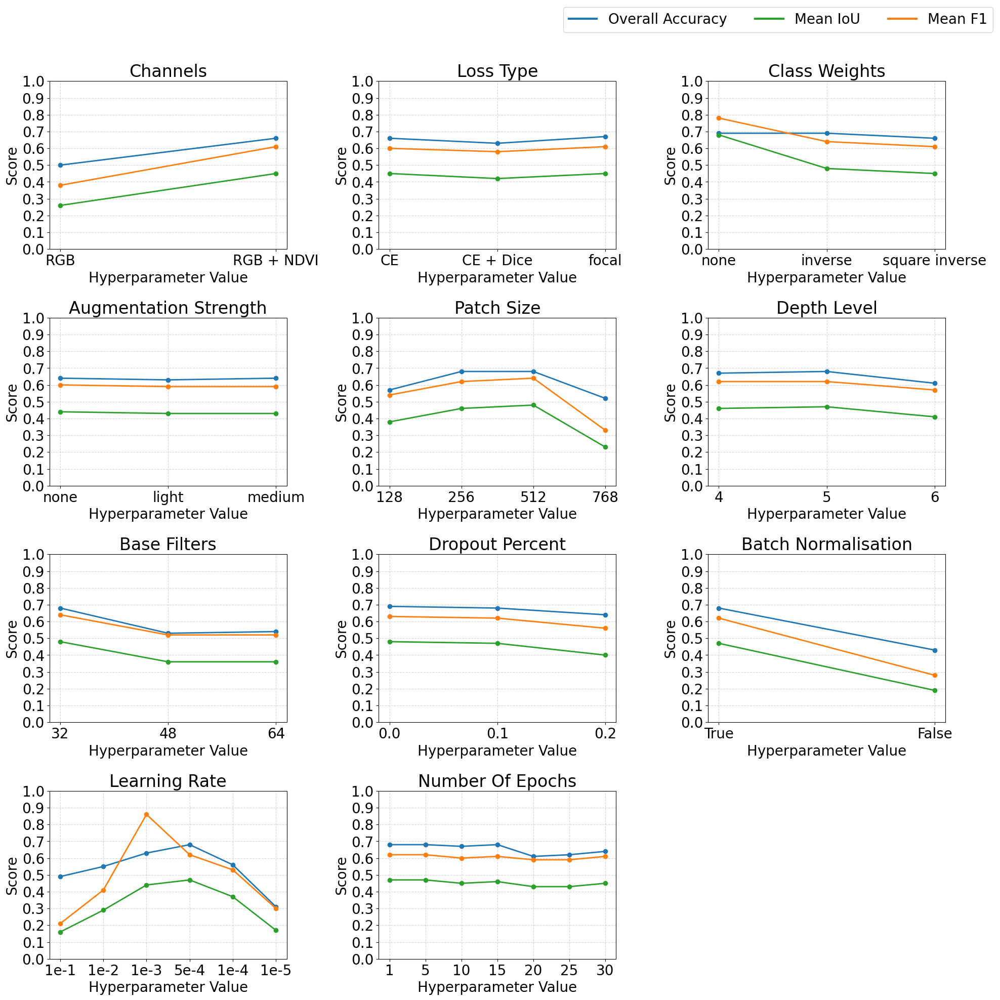

In [52]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams.update({'font.size': 20})   # global font size

# ===============================
# EXAMPLE HYPERPARAMETER RESULTS
# ===============================
hyper_results = {
    "channels": {
        "values": ["RGB", "RGB + NDVI"],
        "oa": [0.50, 0.66],
        "miou": [0.26, 0.45],
        "mf1": [0.38, 0.61],
    },
    "loss_type": {
        "values": ["CE", "CE + Dice", "focal"],
        "oa": [0.66, 0.63, 0.67],
        "miou": [0.45, 0.42, 0.45],
        "mf1": [0.60, 0.58, 0.61],
    },
    "class_weights": {
        "values": ["none", "inverse", "square inverse"],
        "oa": [0.69, 0.69, 0.66],
        "miou": [0.68, 0.48, 0.45],
        "mf1": [0.78, 0.64, 0.61],
    },
    "augmentation_strength": {
        "values": ["none", "light", "medium"],
        "oa": [0.64, 0.63, 0.64],
        "miou": [0.44, 0.43, 0.43],
        "mf1": [0.60, 0.59, 0.59],
    },
    "patch_size": {
        "values": ["128", "256", "512", "768"],
        "oa": [0.57, 0.68, 0.68, 0.52],
        "miou": [0.38, 0.46, 0.48, 0.23],
        "mf1": [0.54, 0.62, 0.64, 0.33],
    },
    "depth_level": {
        "values": ["4", "5", "6"],
        "oa": [0.67, 0.68, 0.61],
        "miou": [0.46, 0.47, 0.41],
        "mf1": [0.62, 0.62, 0.57],
    },
    "base_filters": {
        "values": ["32", "48", "64"],
        "oa": [0.68, 0.53, 0.54],
        "miou": [0.48, 0.36, 0.36],
        "mf1": [0.64, 0.52, 0.52],
    },
    "dropout_percent": {
        "values": ["0.0", "0.1", "0.2"],
        "oa": [0.69, 0.68, 0.64],
        "miou": [0.48, 0.47, 0.40],
        "mf1": [0.63, 0.62, 0.56],
    },
    "batch_normalisation": {
        "values": ["True", "False"],
        "oa": [0.68, 0.43],
        "miou": [0.47, 0.19],
        "mf1": [0.62, 0.28],
    },
    "learning_rate": {
        "values": ["1e-1", "1e-2", "1e-3", "5e-4", "1e-4", "1e-5"],
        "oa": [0.49, 0.55, 0.63, 0.68, 0.56, 0.31],
        "miou": [0.16, 0.29, 0.44, 0.47, 0.37, 0.17],
        "mf1": [0.21, 0.41, 0.860, 0.62, 0.53, 0.30],
    },
    "number_of_epochs": {
        "values": ["1", "5", "10", "15", "20", "25", "30"],
        "oa": [0.68, 0.68, 0.67, 0.68, 0.61, 0.62, 0.64],
        "miou": [0.47, 0.47, 0.45, 0.46, 0.43, 0.43, 0.45],
        "mf1": [0.62, 0.62, 0.60, 0.61, 0.59, 0.59, 0.61],
    }
}

# ===============================
# PLOT SETTINGS
# ===============================
nrows, ncols = 4, 3
fig, axes = plt.subplots(nrows, ncols, figsize=(20, 20))  # fits PowerPoint slide width
axes = axes.flatten()

# Order: OA, mIoU, mF1
colors = {"oa": "tab:blue", "miou": "tab:green", "mf1": "tab:orange"}
labels = {"oa": "Overall Accuracy", "miou": "Mean IoU", "mf1": "Mean F1"}

# ===============================
# PLOT LOOP
# ===============================
for ax, (param, results) in zip(axes, hyper_results.items()):
    x = np.arange(len(results["values"]))
    for key in ["oa", "miou", "mf1"]:
        ax.plot(results["values"], results[key],
                marker="o", linewidth=2, color=colors[key], label=labels[key])
    
    ax.set_title(param.replace("_", " ").title())
    ax.set_xlabel("Hyperparameter Value")
    ax.set_ylabel("Score")
    ax.set_ylim(0.0, 1.0)
    ax.set_yticks(np.arange(0.0, 1.1, 0.1))
    ax.grid(True, linestyle="--", alpha=0.5)
    if isinstance(results["values"][0], str):
        ax.set_xticks(range(len(results["values"])))
        ax.set_xticklabels(results["values"], rotation=0, ha="center")

# Hide unused axes
for ax in axes[len(hyper_results):]:
    ax.axis("off")

# ===============================
# GLOBAL STYLING AND SAVE
# ===============================
fig.legend(
    handles=[
        plt.Line2D([0], [0], color=colors[k], lw=3, label=labels[k])
        for k in ["oa", "miou", "mf1"]
    ],
    loc="upper right", ncol=3,
)

plt.tight_layout(rect=[0, 0, 1, 0.95])

# Save the figure
#output_path = "hyperparameter_results.png"
#fig.savefig(output_path, dpi=300, bbox_inches="tight", facecolor="white")
#print(f"Figure saved as {output_path}")

plt.show()

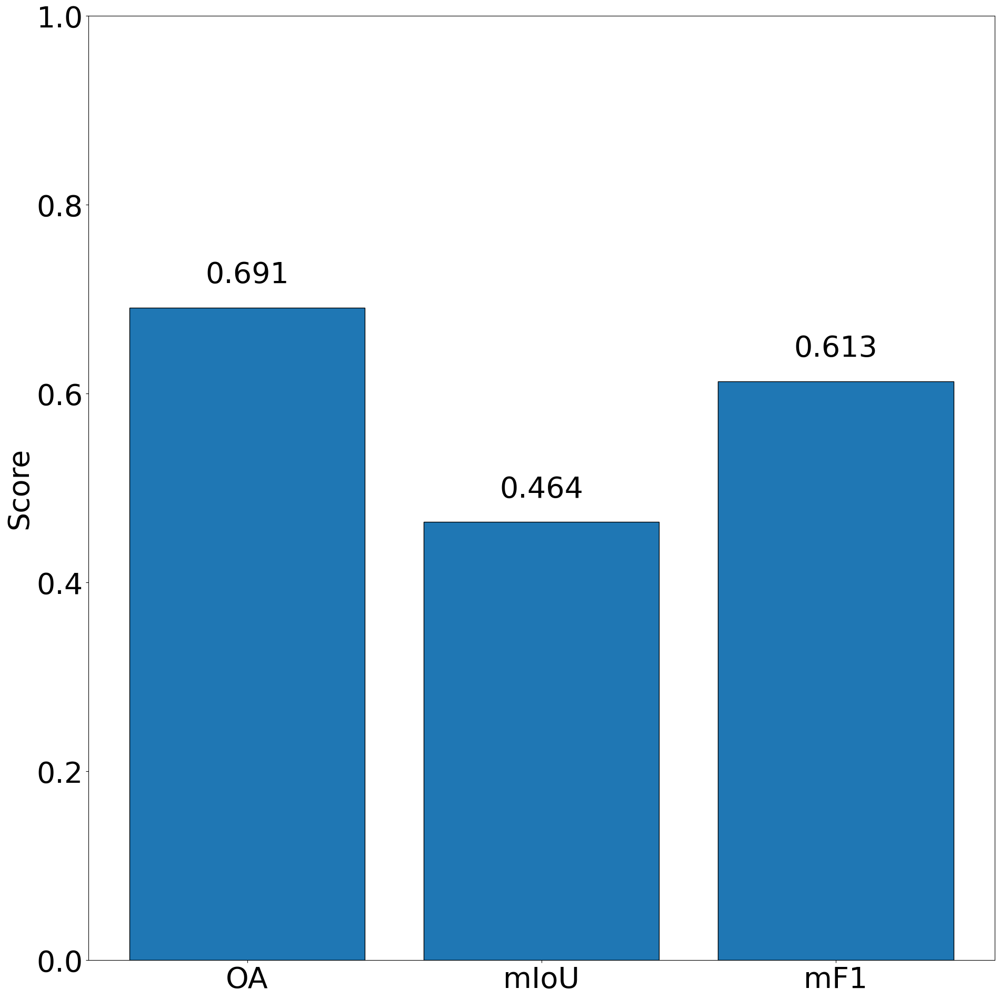

In [67]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams.update({'font.size': 40})

# --- Data ---
overall_names = ["OA", "mIoU", "mF1"]
overall_vals  = [0.691, 0.464, 0.613]

# --- Plot ---
plt.figure(figsize=(20, 20))
plt.bar(range(len(overall_names)), overall_vals, color="#1f77b4", edgecolor="black")

# X-axis
plt.xticks(range(len(overall_names)), overall_names)
plt.ylim(0, 1)

# Annotate bar values
for i, v in enumerate(overall_vals):
    plt.text(i, v + 0.02, f"{v:.3f}", ha="center", va="bottom")

# Title and layout
plt.ylabel("Score")
plt.tight_layout()
plt.show()

# Accuracy Comparision

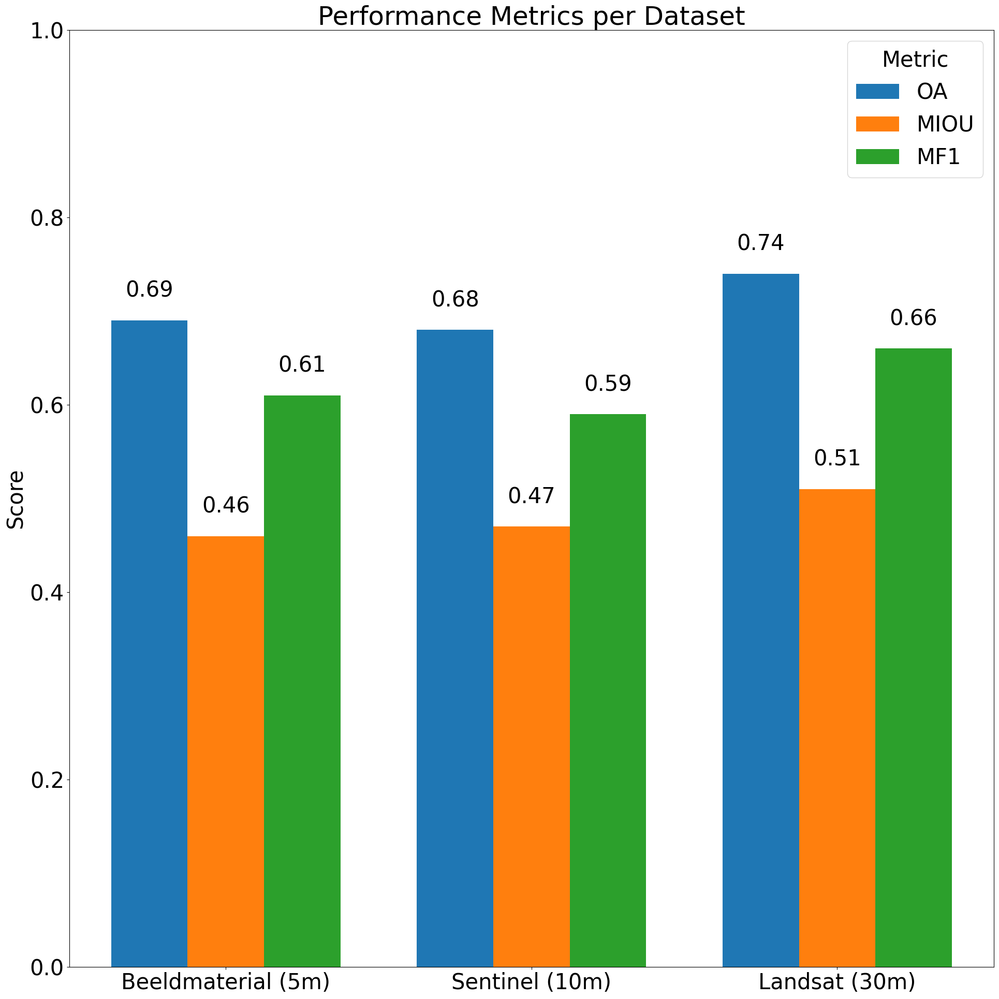

In [73]:
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams.update({'font.size': 30})


# --- Create dictionary ---
metrics_dict = {
    "Beeldmaterial (5m)": {"oa": 0.69, "miou": 0.46, "mf1": 0.61},
    "Sentinel (10m)": {"oa": 0.68, "miou": 0.47, "mf1": 0.59},
    "Landsat (30m)": {"oa": 0.74, "miou": 0.51, "mf1": 0.66},
}

# --- Prepare data for plotting ---
people = list(metrics_dict.keys())
metrics = list(next(iter(metrics_dict.values())).keys())  # ['oa', 'miou', 'mf1']

# Convert to 2D list for plotting
values = np.array([[metrics_dict[p][m] for m in metrics] for p in people])

# --- Grouped bar plot ---
x = np.arange(len(people))  # group positions
bar_width = 0.25

fig, ax = plt.subplots(figsize=(20, 20))

for i, metric in enumerate(metrics):
    ax.bar(x + i * bar_width, values[:, i], width=bar_width, label=metric.upper())

# --- Labels & formatting ---
ax.set_xticks(x + bar_width)
ax.set_xticklabels(people)
ax.set_ylim(0, 1)
ax.set_ylabel("Score")
ax.set_title("Performance Metrics per Dataset")
ax.legend(title="Metric")

# Annotate values
for i, metric in enumerate(metrics):
    for j, v in enumerate(values[:, i]):
        ax.text(x[j] + i * bar_width, v + 0.02, f"{v:.2f}", ha="center", va="bottom")

plt.tight_layout()
plt.show()